# Modulo de contagem para lista de imagens

##  Importar os módulos

In [4]:
import os
import cv2
import pandas as pd
from matplotlib import pyplot as plt
from ultralytics import YOLO
from time import time

## 1 - Declarar Funções

In [5]:
def createNameImage(paths_image):
    name_format = paths_image.split("\\")[-1]
    image_name=name_format.split(".")[0] 
    
    return image_name

#Cria uma Lista com o Nome de todas as imagens no path de entrada 
def createListNameImageFiles(input_path):

    from pathlib import Path
    images = Path(input_path).glob("*.jpg")
    image_names_list = [str(p) for p in images]

    return image_names_list



# Esta função recebe um path da imagem, carrega e retorna uma imagem BGR 
def loadImage(IMAGE_PATH):
    print("Carregando imagem " + IMAGE_PATH)
    imagem = cv2.imread(IMAGE_PATH)
    
    return imagem

# Esta função recebe uma imagem e realiza a vizualização
def showImage(imagem):
    print("Visualizando a imagem...")
    plt.imshow(cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB))
    plt.show()
    
# Esta função recebe o caminho do modelo e carrega e retorna um modelo yolo de detecção de objetos
def loadYOLOModel(MODEL_PATH):
    model = YOLO(MODEL_PATH)
    print("Carregando modelo de detecção YOLO " + MODEL_PATH)
    return model

# Esta função recebe uma imagem e as dimenções de largura e altura das janelas. Por fim,retorna um vetor de janelas dessa imagem
def generateWindows(imagem_orig, WIN_WIDTH, WIN_HEIGHT):
    altura, largura, canal = imagem_orig.shape
    
    n_largura = int(largura/WIN_WIDTH)
    n_altura = int(altura/WIN_HEIGHT)
    
    
    i = 1
    x1 = 0
    y1 = 0
    x2 = WIN_WIDTH
    y2 = WIN_HEIGHT
    
    windows_vetor = []
    
    for a in range(n_altura):
        for l in range(n_largura):
            
            #img_draft = cv2.rectangle(imagem_orig, (x1, y1), (x2, y2), (255,0,0), 4)
            #showImage(img_draft)
            windows_img = imagem_orig[y1:y2, x1:x2]
            windows_vetor.append(windows_img)
            #showImage(windows_img)
            
            
            i = i + 1
            x1 = x1 + WIN_WIDTH
            x2 = x2 + WIN_WIDTH
            l = l + 1           
        
        x1 = 0
        y1 = y2
        x2 = WIN_WIDTH
        y2 = y2 + WIN_HEIGHT
        a = a + 1

    return windows_vetor

# Esta função recebe uma imagem em janela, ID da janela, o modelo de detecção e o valor threshold para realizar a detecção e
# contagem dos objetos existentes na janela. Por fim, retorna o numero de vacas detectadas na janela e também retorna um 
# um Dataframe com a posição das detecções.

def detectAndCountWindows(win_image, win_ID, model, DETECTION_THRESHOLD):
    frame = win_image
    results = model(win_image, verbose=False)[0]
    
    class_name_dict = {0: 'cow', 1:'noCow'}
    
    cow_number = 0
    
    row_list = []
    
    for result in results.boxes.data.tolist():
        x1, y1, x2, y2, score, class_id = result
            
        if int(class_id) != 0:
            pass

        else:

            if score > DETECTION_THRESHOLD:
                cow_number = cow_number + 1
                
                #cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
                #cv2.putText(frame, class_name_dict[int(class_id)].upper()+"_"+str(round(score)*100)+"%", (int(x1), int(y1 - 10)),
                 #           cv2.FONT_HERSHEY_SIMPLEX, 1.3, (0, 255, 0), 3, cv2.LINE_AA)

                value = [win_ID, 'cow', x1, y1, x2, y2, score]
                row_list.append(value)

                #plt.imshow(frame)
                #plt.show()
                

    column_name = ['win_ID', 'classe', 'x1', 'y1', 'x2', 'y2', 'scores']
    detections_df = pd.DataFrame(row_list, columns=column_name)
                
    return cow_number, detections_df

# Esta função recebe o vetor de janelas, o modelo e o threshold. Em seguida, Retorna a contagem total de vacas e um Dataframe 
# com as posições
def countingCows(windows_vetor, model, DETECTION_THRESHOLD):
    
    win_ID = 0
    vetor_qt_cows = []
    
    row_list = []
    column_name = ['win_ID', 'classe', 'x1', 'y1', 'x2', 'y2', 'scores']
    final_detection_df = pd.DataFrame(row_list, columns=column_name)
    
    for win_image in windows_vetor:
        
        cow_number, detections_df = detectAndCountWindows(win_image, win_ID, model, DETECTION_THRESHOLD)
        
        vetor_qt_cows.append(cow_number)
        final_detection_df = pd.concat([final_detection_df, detections_df])
        
        win_ID = win_ID + 1
        
        
    qt_cows = sum(vetor_qt_cows)
    
    return qt_cows, final_detection_df.reset_index(drop=True)

def convetBBoxWinToBBoxOrig(win_x1, win_y1, win_x2, win_y2, win_ID, WIN_WIDTH, WIN_HEIGHT, n_largura, n_altura):
    
    i = 0
    x1 = 0
    y1 = 0
    x2 = WIN_WIDTH
    y2 = WIN_HEIGHT
    
    windows_vetor = []
    
    for a in range(n_altura):
        for l in range(n_largura):
            
            if i == win_ID:
                orig_x1 = x1 + win_x1
                orig_y1 = y1 + win_y1
                orig_x2 = x1 + win_x2
                orig_y2 = y1 + win_y2
                
                return orig_x1, orig_y1, orig_x2, orig_y2

            
            
            i = i + 1
            x1 = x1 + WIN_WIDTH
            x2 = x2 + WIN_WIDTH
            l = l + 1           
        
        x1 = 0
        y1 = y2
        x2 = WIN_WIDTH
        y2 = y2 + WIN_HEIGHT
        a = a + 1
    
    
    return orig_x1, orig_y1, orig_x2, orig_y2

def writeNumCow(image, qt_total_cow):
    # font
    font = cv2.FONT_HERSHEY_SIMPLEX

    # org
    org = (100, 200)

    # fontScale
    fontScale = 5

    # Blue color in BGR
    color = (0, 255, 0)

    # Line thickness of 2 px
    thickness = 10

    # Using cv2.putText() method
    image = cv2.putText(image, "Numero de Vacas: " + str(qt_total_cow), org, font, 
                       fontScale, color, thickness, cv2.LINE_AA)
    
    return image
    
    
def printDetections(imagem_orig, qt_cows, final_detection_df, WIN_WIDTH, WIN_HEIGHT):
    
    altura, largura, canal = imagem_orig.shape
    
    n_largura = int(largura/WIN_WIDTH)
    n_altura = int(altura/WIN_HEIGHT)
    
    
    n_detections = len(final_detection_df)
    for i in range(n_detections):
        
        win_ID = final_detection_df.iloc[i][0]
        classe = final_detection_df.iloc[i][1]
        win_x1 = final_detection_df.iloc[i][2]
        win_y1 = final_detection_df.iloc[i][3]
        win_x2 = final_detection_df.iloc[i][4]
        win_y2 = final_detection_df.iloc[i][5]
        score = final_detection_df.iloc[i][6]
        
        x1, y1, x2, y2 = convetBBoxWinToBBoxOrig(win_x1, win_y1, win_x2, win_y2, win_ID, WIN_WIDTH, WIN_HEIGHT, n_largura, n_altura)

        cv2.rectangle(imagem_orig, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 10)
        cv2.putText(imagem_orig, classe + "_" + str(i+1), (int(x1), int(y1 - 10)), cv2.FONT_HERSHEY_SIMPLEX, 2.5, (0, 255, 0), 8, cv2.LINE_AA)
        
    
    writeNumCow(imagem_orig, qt_cows)
    showImage(imagem_orig)
    

In [18]:
DATASET_ORIG_PATH = "C:\\NEW_TCC\\dataset\\validacao\\renomeados"
MODEL_PATH = os.path.join('.', 'runs', 'detect', 'train3', 'weights', 'best.pt')
OUTPUT_COUNTING_PATH = "C:\\NEW_TCC\\output\\validacao\\dataset_v2"

WIN_WIDTH = 200
WIN_HEIGHT = 200
DETECTION_THRESHOLD = 0.71

Carregando modelo de detecção YOLO .\runs\detect\train3\weights\best.pt
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow1.JPG
Visualizando a imagem...


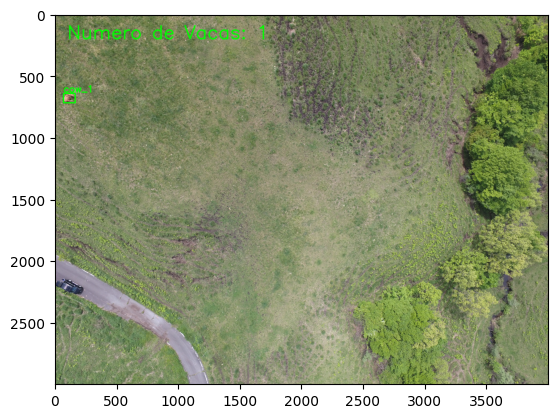

C:\NEW_TCC\dataset\validacao\renomeados\cow1.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow10.JPG
Visualizando a imagem...


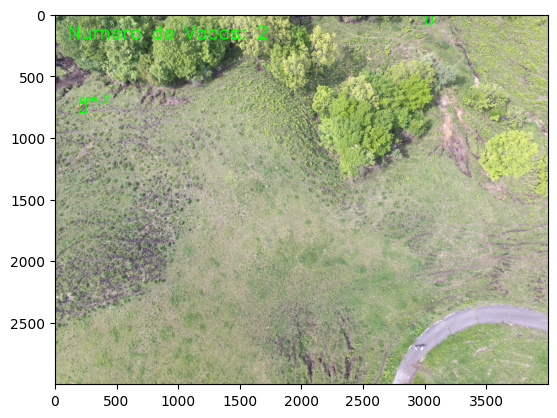

C:\NEW_TCC\dataset\validacao\renomeados\cow10.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow11.JPG
Visualizando a imagem...


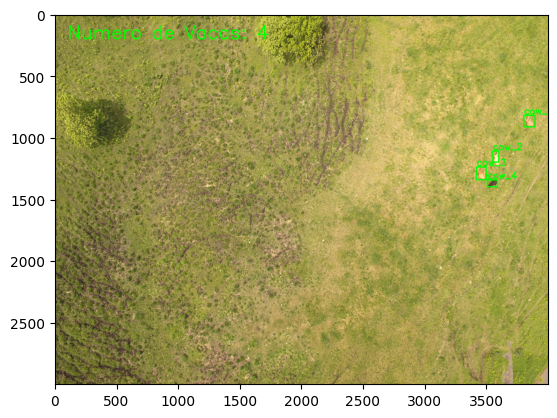

C:\NEW_TCC\dataset\validacao\renomeados\cow11.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow12.JPG
Visualizando a imagem...


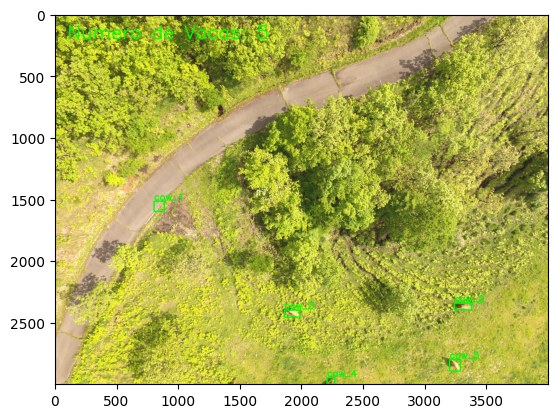

C:\NEW_TCC\dataset\validacao\renomeados\cow12.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow13.JPG
Visualizando a imagem...


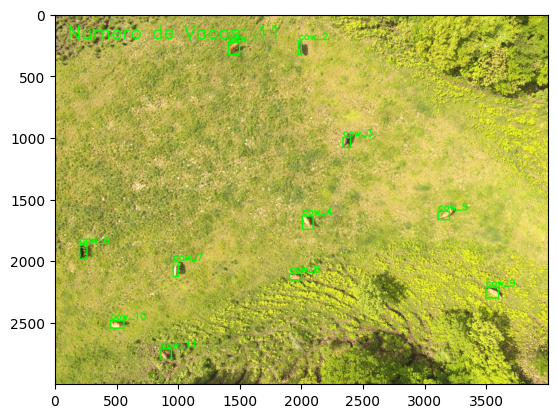

C:\NEW_TCC\dataset\validacao\renomeados\cow13.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow14.JPG
Visualizando a imagem...


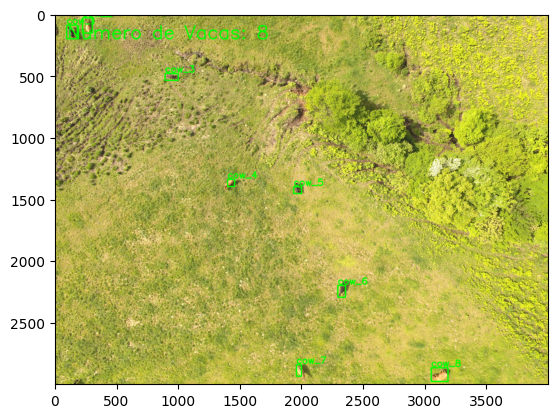

C:\NEW_TCC\dataset\validacao\renomeados\cow14.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow15.JPG
Visualizando a imagem...


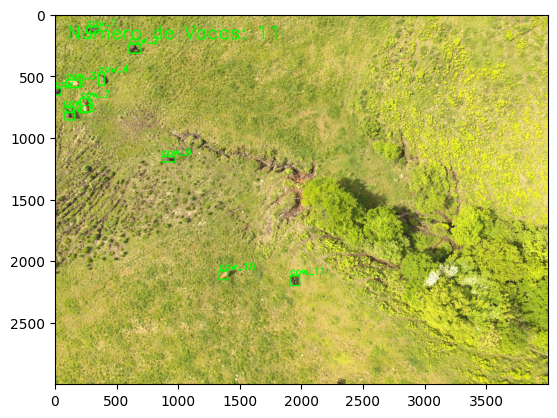

C:\NEW_TCC\dataset\validacao\renomeados\cow15.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow16.JPG
Visualizando a imagem...


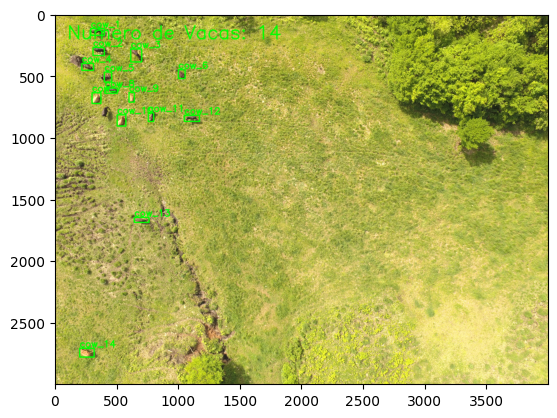

C:\NEW_TCC\dataset\validacao\renomeados\cow16.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow17.JPG
Visualizando a imagem...


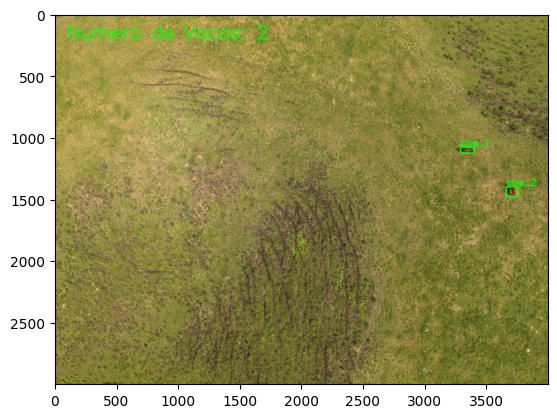

C:\NEW_TCC\dataset\validacao\renomeados\cow17.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow18.JPG
Visualizando a imagem...


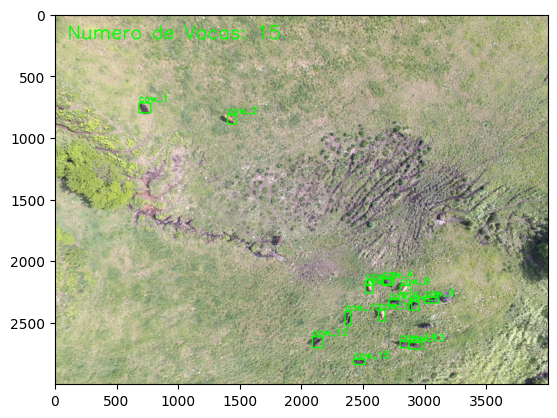

C:\NEW_TCC\dataset\validacao\renomeados\cow18.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow19.JPG
Visualizando a imagem...


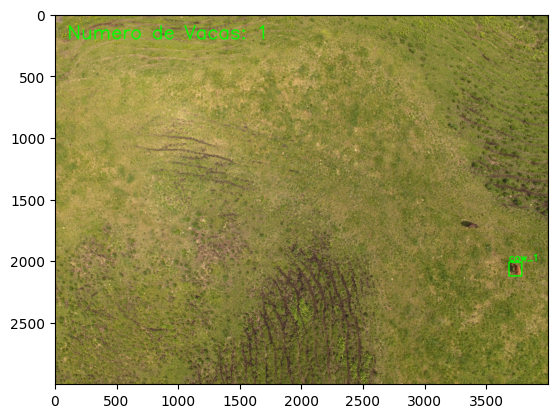

C:\NEW_TCC\dataset\validacao\renomeados\cow19.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow2.JPG
Visualizando a imagem...


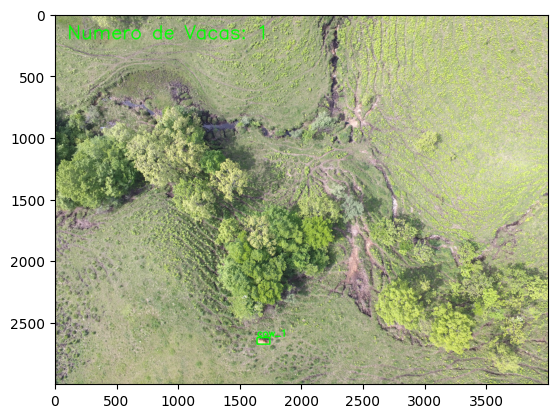

C:\NEW_TCC\dataset\validacao\renomeados\cow2.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow20.JPG
Visualizando a imagem...


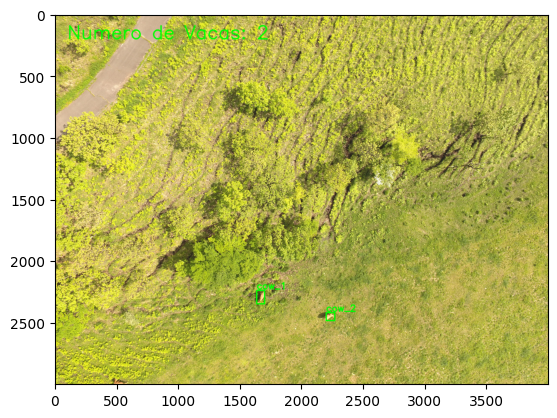

C:\NEW_TCC\dataset\validacao\renomeados\cow20.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow21.JPG
Visualizando a imagem...


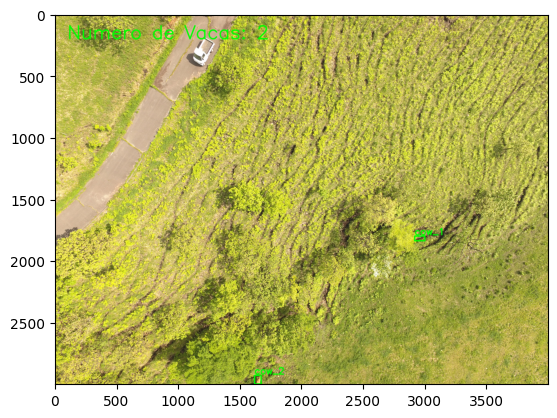

C:\NEW_TCC\dataset\validacao\renomeados\cow21.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow22.JPG
Visualizando a imagem...


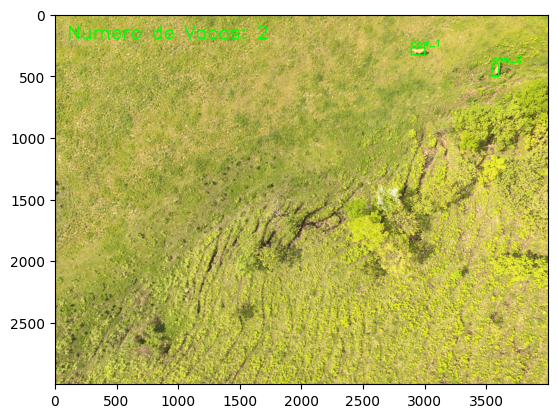

C:\NEW_TCC\dataset\validacao\renomeados\cow22.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow23.JPG
Visualizando a imagem...


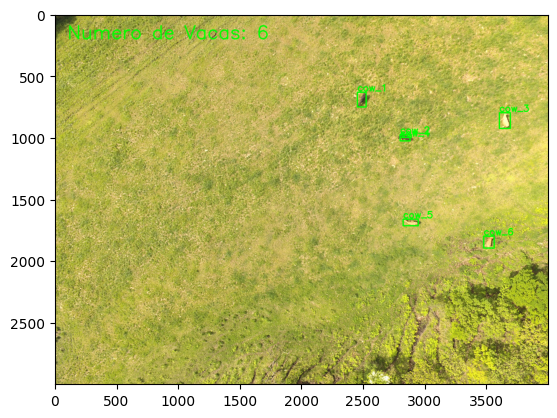

C:\NEW_TCC\dataset\validacao\renomeados\cow23.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow24.JPG
Visualizando a imagem...


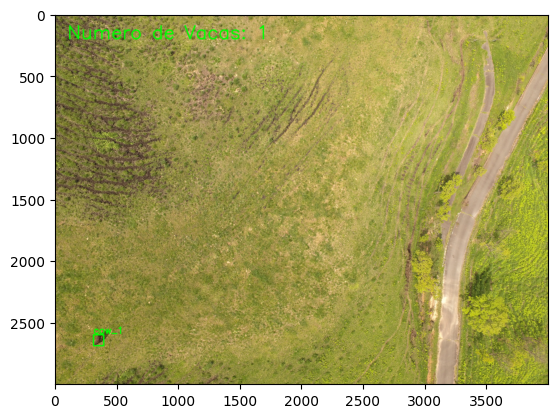

C:\NEW_TCC\dataset\validacao\renomeados\cow24.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow25.JPG
Visualizando a imagem...


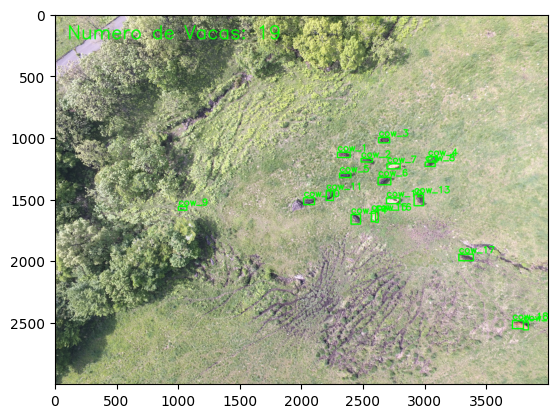

C:\NEW_TCC\dataset\validacao\renomeados\cow25.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow26.JPG
Visualizando a imagem...


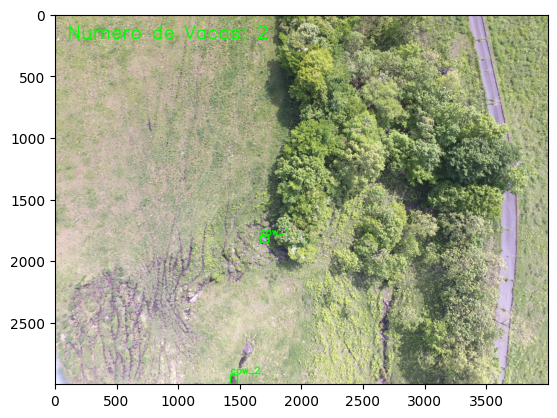

C:\NEW_TCC\dataset\validacao\renomeados\cow26.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow27.JPG
Visualizando a imagem...


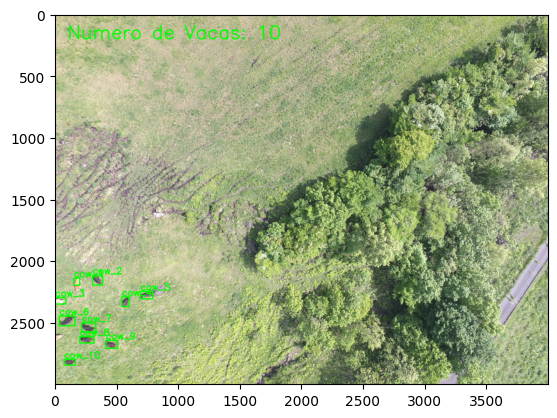

C:\NEW_TCC\dataset\validacao\renomeados\cow27.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow28.JPG
Visualizando a imagem...


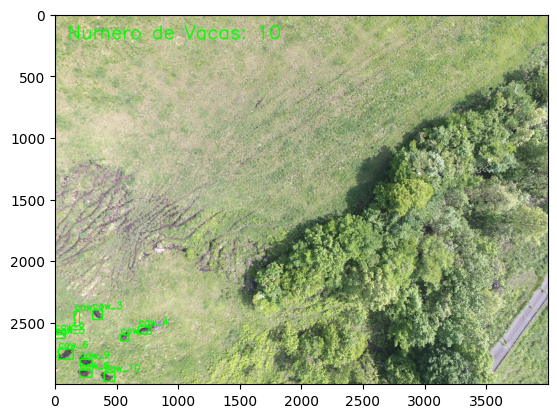

C:\NEW_TCC\dataset\validacao\renomeados\cow28.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow29.JPG
Visualizando a imagem...


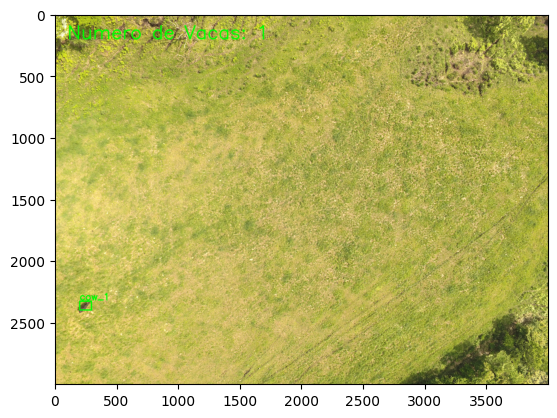

C:\NEW_TCC\dataset\validacao\renomeados\cow29.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow3.JPG
Visualizando a imagem...


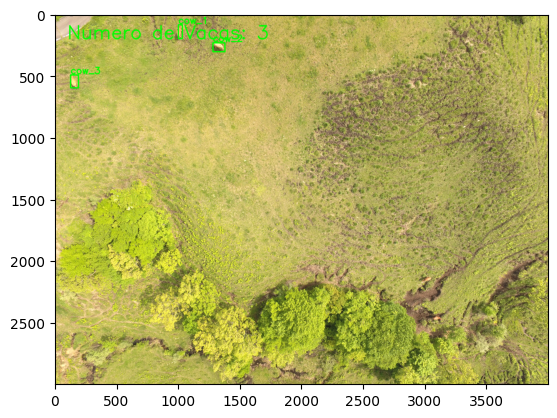

C:\NEW_TCC\dataset\validacao\renomeados\cow3.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow30.JPG
Visualizando a imagem...


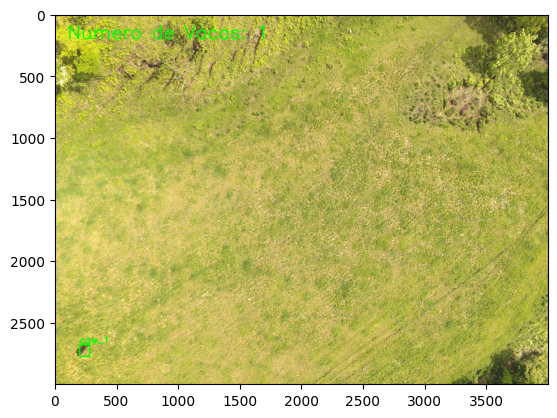

C:\NEW_TCC\dataset\validacao\renomeados\cow30.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow31.JPG
Visualizando a imagem...


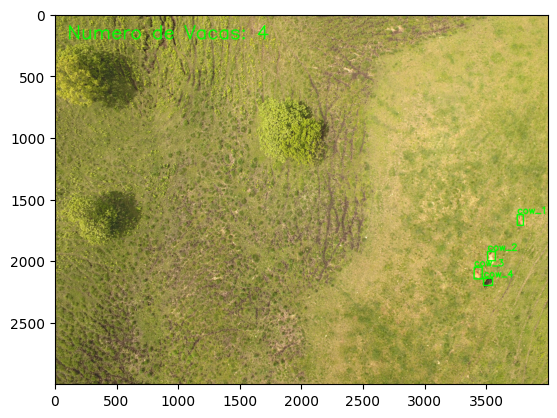

C:\NEW_TCC\dataset\validacao\renomeados\cow31.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow32.JPG
Visualizando a imagem...


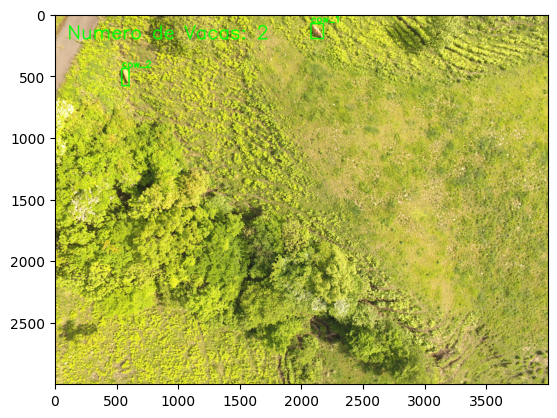

C:\NEW_TCC\dataset\validacao\renomeados\cow32.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow33.JPG
Visualizando a imagem...


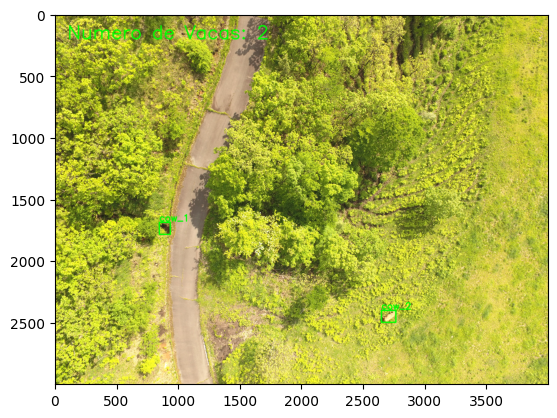

C:\NEW_TCC\dataset\validacao\renomeados\cow33.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow34.JPG
Visualizando a imagem...


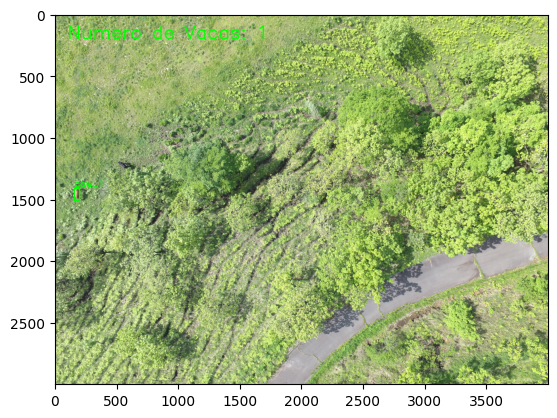

C:\NEW_TCC\dataset\validacao\renomeados\cow34.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow35.JPG
Visualizando a imagem...


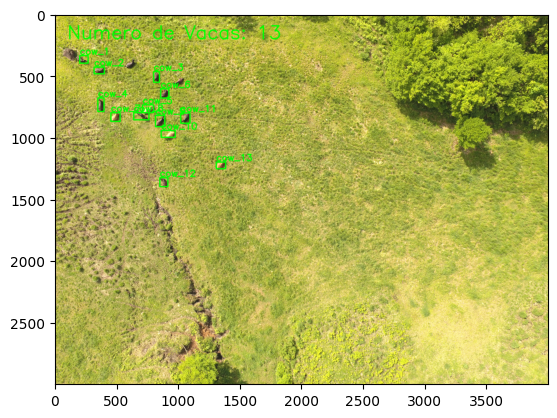

C:\NEW_TCC\dataset\validacao\renomeados\cow35.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow36.JPG
Visualizando a imagem...


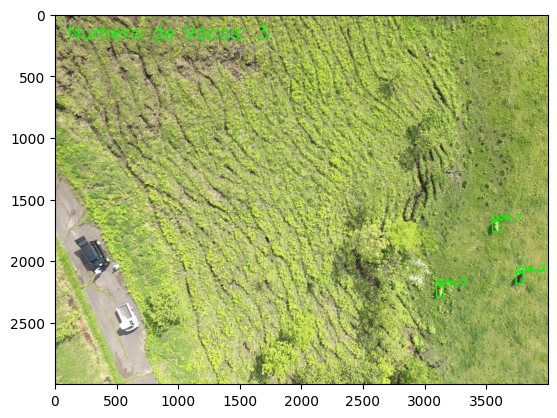

C:\NEW_TCC\dataset\validacao\renomeados\cow36.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow37.JPG
Visualizando a imagem...


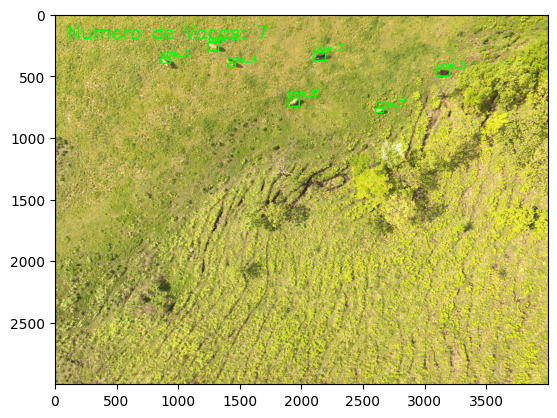

C:\NEW_TCC\dataset\validacao\renomeados\cow37.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow38.JPG
Visualizando a imagem...


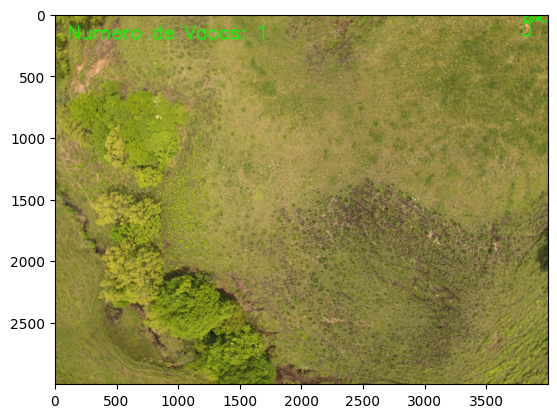

C:\NEW_TCC\dataset\validacao\renomeados\cow38.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow39.JPG
Visualizando a imagem...


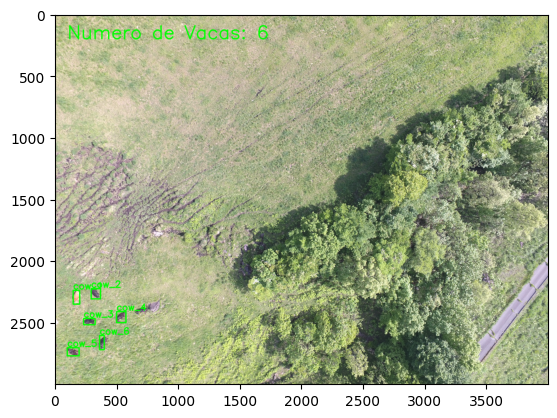

C:\NEW_TCC\dataset\validacao\renomeados\cow39.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow4.JPG
Visualizando a imagem...


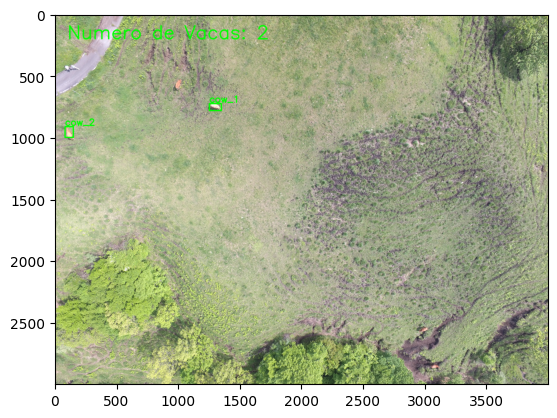

C:\NEW_TCC\dataset\validacao\renomeados\cow4.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow40.JPG
Visualizando a imagem...


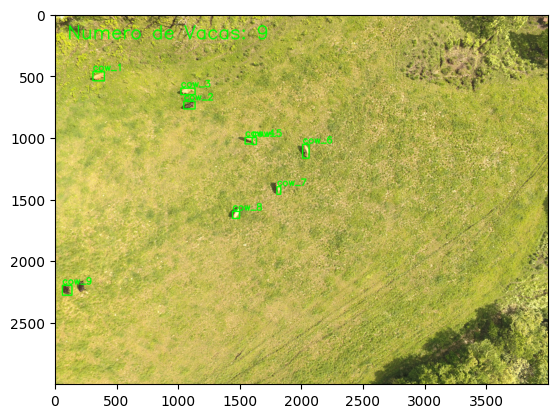

C:\NEW_TCC\dataset\validacao\renomeados\cow40.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow41.JPG
Visualizando a imagem...


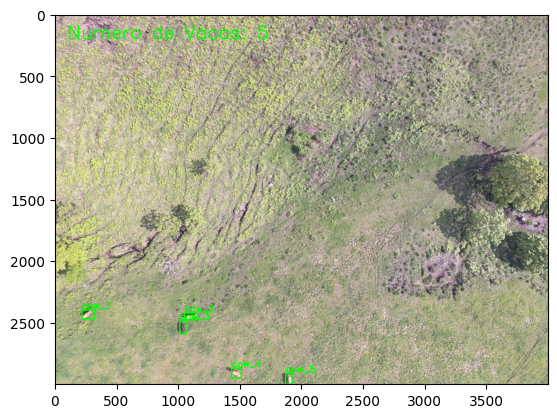

C:\NEW_TCC\dataset\validacao\renomeados\cow41.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow42.JPG
Visualizando a imagem...


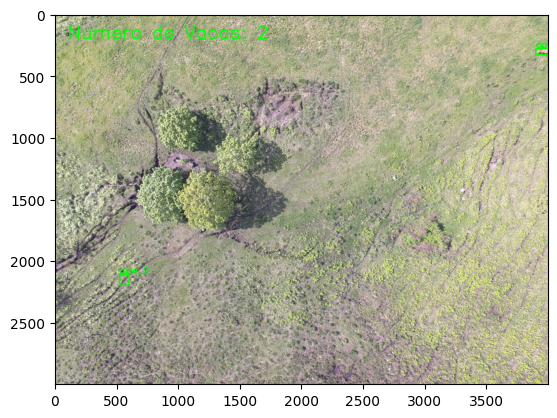

C:\NEW_TCC\dataset\validacao\renomeados\cow42.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow43.JPG
Visualizando a imagem...


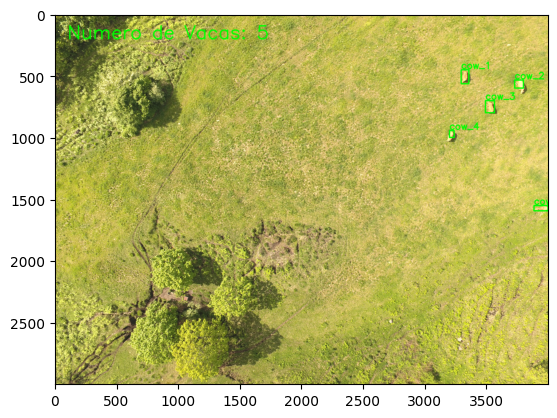

C:\NEW_TCC\dataset\validacao\renomeados\cow43.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow44.JPG
Visualizando a imagem...


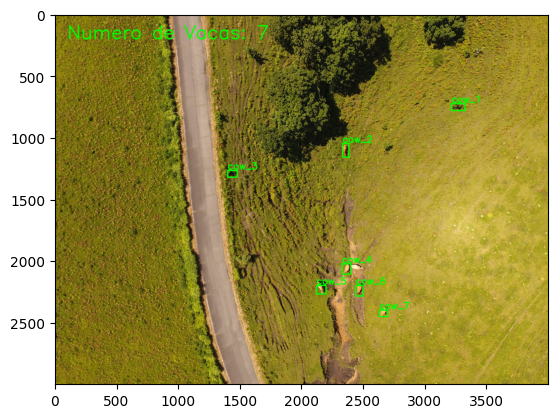

C:\NEW_TCC\dataset\validacao\renomeados\cow44.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow45.JPG
Visualizando a imagem...


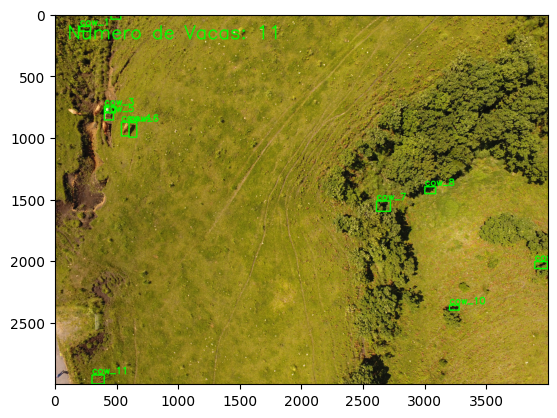

C:\NEW_TCC\dataset\validacao\renomeados\cow45.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow46.JPG
Visualizando a imagem...


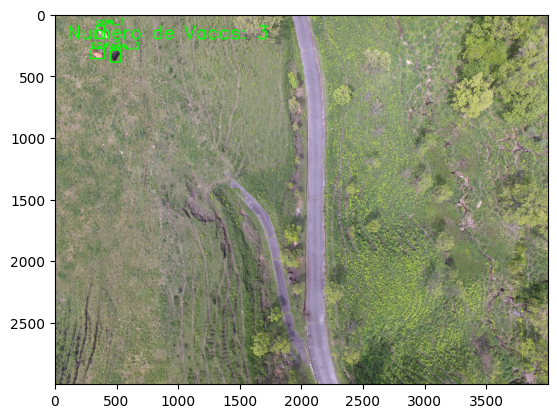

C:\NEW_TCC\dataset\validacao\renomeados\cow46.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow47.JPG
Visualizando a imagem...


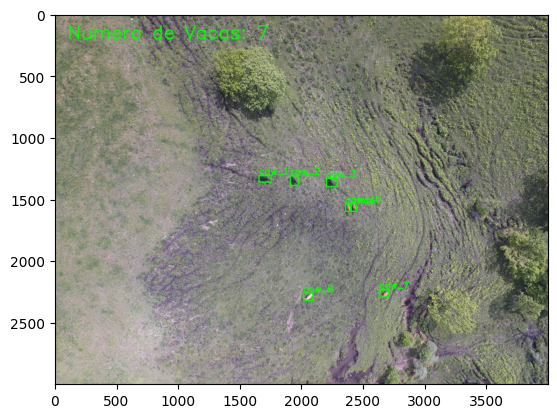

C:\NEW_TCC\dataset\validacao\renomeados\cow47.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow5.JPG
Visualizando a imagem...


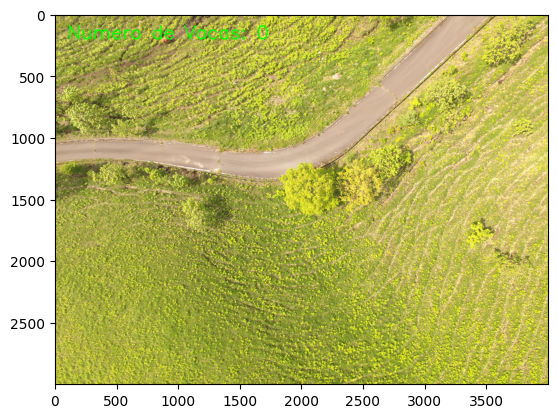

C:\NEW_TCC\dataset\validacao\renomeados\cow5.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow6.JPG
Visualizando a imagem...


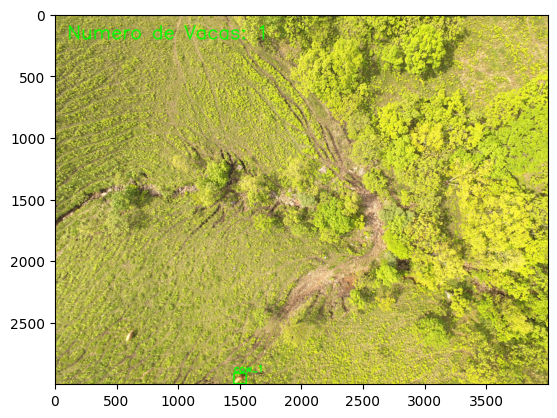

C:\NEW_TCC\dataset\validacao\renomeados\cow6.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow7.JPG
Visualizando a imagem...


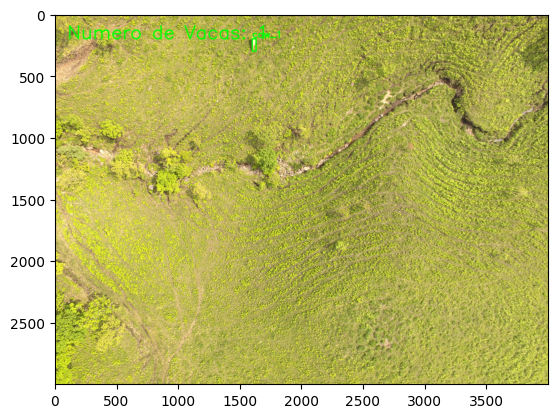

C:\NEW_TCC\dataset\validacao\renomeados\cow7.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow8.JPG
Visualizando a imagem...


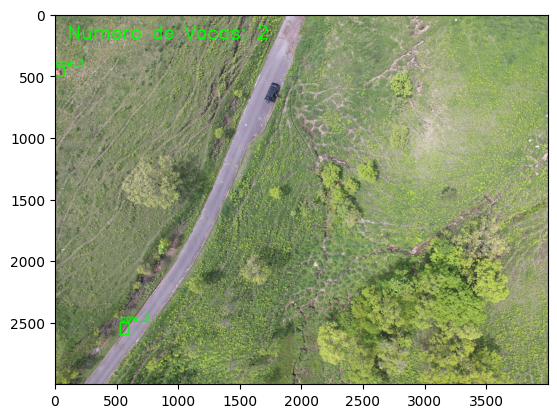

C:\NEW_TCC\dataset\validacao\renomeados\cow8.JPG
Carregando imagem C:\NEW_TCC\dataset\validacao\renomeados\cow9.JPG
Visualizando a imagem...


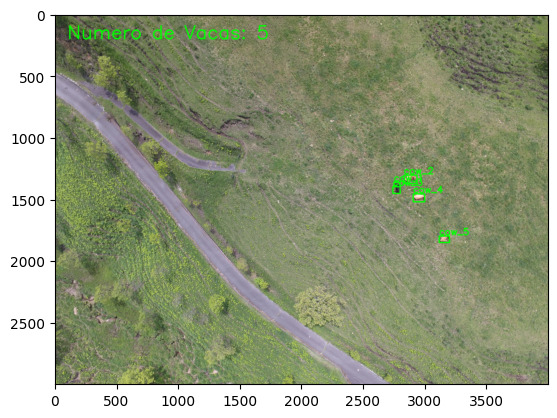

C:\NEW_TCC\dataset\validacao\renomeados\cow9.JPG


In [19]:
model = loadYOLOModel(MODEL_PATH)

image_names_list = createListNameImageFiles(DATASET_ORIG_PATH)

lista_time = []
lista_image_name = []

for paths_image in image_names_list:
    
    
    imagem_orig = loadImage(paths_image)
    
    inicio = time()

    windows_vetor = generateWindows(imagem_orig, WIN_WIDTH, WIN_HEIGHT)

    qt_cows, final_detection_df = countingCows(windows_vetor, model, DETECTION_THRESHOLD)

    printDetections(imagem_orig, qt_cows, final_detection_df, WIN_WIDTH, WIN_HEIGHT)
    
    fim = time()
    
    TC = fim - inicio
    lista_time.append(TC)
    
    image_name = createNameImage(paths_image)
    lista_image_name.append(image_name)
    
    OUTPUT_PATH = os.path.join(OUTPUT_COUNTING_PATH, image_name + ".JPG")
    cv2.imwrite(OUTPUT_PATH, imagem_orig)
    
    print(paths_image)

In [20]:

row_list = []
column_name = ['filename', 'time']
time_detections_df = pd.DataFrame(row_list, columns=column_name)
time_detections_df['filename'] = lista_image_name
time_detections_df['time'] = lista_time

time_detections_df.to_csv(os.path.join(OUTPUT_COUNTING_PATH, 'time_counting.csv'), index=False, encoding='utf-8')
time_detections_df

,filename,time
0,cow1,4.796906
1,cow10,4.537233
2,cow11,4.343199
3,cow12,4.425981
4,cow13,4.571556
5,cow14,4.491804
6,cow15,4.528700
7,cow16,4.564603
8,cow17,4.464876
9,cow18,4.630432


In [27]:
VALIDATION_IMAGES_PATH = "C:\\NEW_TCC\\dataset\\validacao\\renomeados"
VALIDATION_ANOTATION_DF_PATH = os.path.join(VALIDATION_IMAGES_PATH, "val_annotation.csv")

VAL_QT_REAL_PATH = os.path.join(VALIDATION_IMAGES_PATH, "val_qt_real_df.csv")

In [28]:
val_image_list = createListNameImageFiles(VALIDATION_IMAGES_PATH)
val_anotation_df = pd.read_csv(VALIDATION_ANOTATION_DF_PATH)

In [29]:

row_list=[]
for image_path in val_image_list:

    name_image = createNameImage(image_path)
    df=val_anotation_df[val_anotation_df['filename']==name_image+".JPG"]
    qt_val = len(df)
    
    row_list.append([name_image, qt_val])

column_name = ['filename', 'qt_val']
validation_df = pd.DataFrame(row_list, columns=column_name)

In [30]:

df_3 = validation_df.sort_values(by=['filename'], ascending=True)
df_3.to_csv(VAL_QT_REAL_PATH,index=False)
df_3

,filename,qt_val
0,cow1,1
1,cow10,1
2,cow11,4
3,cow12,5
4,cow13,11
5,cow14,10
6,cow15,11
7,cow16,15
8,cow17,2
9,cow18,16
